# Parameter scan runs for 2D prescribed flow model

Author: Jatan Buch (v1, 240501)

In [1]:
# PySDM libraries
from PySDM_examples.Szumowski_et_al_1998 import Storage
from PySDM import Formulae
from PySDM.physics import si
from PySDM.initialisation.spectra import Lognormal

from open_atmos_jupyter_utils import TemporaryFile
from PySDM_examples.utils import DummyController
from utils.netcdf_exporter import NetCDFExporter

# mod case files
from case_files.settings_2d import Settings
from case_files.spin_up_2d import SpinUp
from case_files.simulation_2d import Simulation

import numpy as np
import xarray
from tqdm import tqdm
import itertools
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.colors as colors
from utils.plot_params_mpl39 import params
import matplotlib.pylab as pylab
import seaborn as sns
pylab.rcParams.update(params)
cols_default = plt.rcParams['axes.prop_cycle'].by_key()['color']

%matplotlib inline
%config IPython.matplotlib.backend = 'retina'
%config InlineBackend.figure_format = 'retina'

sav_file_path= "../../sav_files/parameter_scan_2D/"

/Users/hyfives-lamont/Desktop/cloud_seeding/PySDM/PySDM/backends/impl_numba/conf.py:19: UserWarning: Disabling Numba threading due to ARM64 CPU (atomics do not work yet)
  warnings.warn(


### Case setup

In [2]:
def pres_2D_flow_run(param, rindx, rseed= 42):

    bkg_size, seed_size, norm_seed, z_part_seed, x_part_seed= param

    np.random.seed(rseed)

    settings = Settings(
        Formulae(seed= np.random.randint(1000)),
        n_sd_per_mode= (32, 32),
        aerosol_modes_by_kappa= {
                .3: Lognormal(
                            norm_factor= 10 / si.cm ** 3,
                            m_mode= bkg_size,
                            s_geom=1.4
                    ),
                .85: Lognormal(
                        norm_factor= norm_seed,
                        m_mode= seed_size,
                        s_geom= 1.2
                    )
                },
        z_part= ((0., 1), z_part_seed),
        x_part= ((0., 1), x_part_seed),
        )

    #settings.n_sd_per_gridbox = 25
    settings.grid = (25, 25) # x-z grid
    settings.size= (1500 * si.metres, 1500 * si.metres)
    settings.simulation_time = 6000 * si.second

    storage = Storage()
    simulation = Simulation(settings, storage, SpinUp)
    simulation.reinit()
    simulation.run()

    rain_arr= []
    for i in settings.output_steps:
        rain_arr.append(storage.load('rain water mixing ratio', i))

    t_arr= np.array([            0,   60000000000,  120000000000,  180000000000,
        240000000000,  300000000000,  360000000000,  420000000000,
        480000000000,  540000000000,  600000000000,  660000000000,
        720000000000,  780000000000,  840000000000,  900000000000,
        960000000000, 1020000000000, 1080000000000, 1140000000000,
       1200000000000, 1260000000000, 1320000000000, 1380000000000,
       1440000000000, 1500000000000, 1560000000000, 1620000000000,
       1680000000000, 1740000000000, 1800000000000, 1860000000000,
       1920000000000, 1980000000000, 2040000000000, 2100000000000,
       2160000000000, 2220000000000, 2280000000000, 2340000000000,
       2400000000000, 2460000000000, 2520000000000, 2580000000000,
       2640000000000, 2700000000000, 2760000000000, 2820000000000,
       2880000000000, 2940000000000, 3000000000000, 3060000000000,
       3120000000000, 3180000000000, 3240000000000, 3300000000000,
       3360000000000, 3420000000000, 3480000000000, 3540000000000,
       3600000000000, 3660000000000, 3720000000000, 3780000000000,
       3840000000000, 3900000000000, 3960000000000, 4020000000000,
       4080000000000, 4140000000000, 4200000000000, 4260000000000,
       4320000000000, 4380000000000, 4440000000000, 4500000000000,
       4560000000000, 4620000000000, 4680000000000, 4740000000000,
       4800000000000, 4860000000000, 4920000000000, 4980000000000,
       5040000000000, 5100000000000, 5160000000000, 5220000000000,
       5280000000000, 5340000000000, 5400000000000, 5460000000000,
       5520000000000, 5580000000000, 5640000000000, 5700000000000,
       5760000000000, 5820000000000, 5880000000000, 5940000000000,
       6000000000000], dtype='timedelta64[ns]')
    z_arr= np.array([  30.,   90.,  150.,  210.,  270.,  330.,  390.,  450.,  510.,  570.,
        630.,  690.,  750.,  810.,  870.,  930.,  990., 1050., 1110., 1170.,
       1230., 1290., 1350., 1410., 1470.], dtype= np.float32)
    x_arr= np.array([  30.,   90.,  150.,  210.,  270.,  330.,  390.,  450.,  510.,  570.,
        630.,  690.,  750.,  810.,  870.,  930.,  990., 1050., 1110., 1170.,
       1230., 1290., 1350., 1410., 1470.], dtype= np.float32)

    rain_xarr= xarray.DataArray(data= np.array(rain_arr), \
                            dims=["T", "X", "Z"],
                            coords=dict(
                                T= (["T"], t_arr,),
                                X= (["X"], x_arr,),
                                Z= (["Z"], z_arr,),)
                            )
    
    return rain_xarr

In [3]:
bkg_size= np.array([1E2 , 5E2]) * si.nm
seed_size= np.array([1E2, 5E2, 1E3]) * si.nm
#norm_bkg= np.array([10, 100]) / si.cm ** 3
norm_seed= np.array([1, 10, 50, 100]) / si.cm ** 3
z_part_seed= ((0., 0.25), (0.25, 0.50), (0.5, 0.75) , (0.75, 1.))
x_part_seed= ((0., 0.25), (0.25, 0.50), (0.5, 0.75))

param_list= list(itertools.product(bkg_size, seed_size, norm_seed, z_part_seed, x_part_seed))
pres_2D_flow_run_df= pd.DataFrame(param_list, columns= ['bkg_size', 'seed_size', 'norm_seed', 'z_part_seed', 'x_part_seed'])

### Parameter scan

In [4]:
mean_surf_prec_arr= []
#sig_surf_prec_arr= []

for i in tqdm(range(len(param_list))):
    try:
        surface_rain= pres_2D_flow_run(param= param_list[i], rindx=i, rseed= 24)
        surface_rain.to_netcdf(sav_file_path + f'pres_2D_flow_run_{i+1}.nc') # saving the netcdf file
        
        mean_surf_prec_arr.append(surface_rain.sel(Z= 30).sum().values)
        #sig_surf_prec_arr.append(surface_rain.sel(z= 25).sum(dim= 't').std(dim= 'run'))
    except:
        try:
            surface_rain= pres_2D_flow_run(param= param_list[i], rindx=i, n_runs= 5, rseed= 96)
            surface_rain.to_netcdf(sav_file_path + f'pres_2D_flow_run_{i+1}.nc') # saving the netcdf file
        
            mean_surf_prec_arr.append(surface_rain.sel(Z= 30).sum().values)
            #sig_surf_prec_arr.append(surface_rain.sel(z= 25).sum(dim= 't').std(dim= 'run'))
        except:
            mean_surf_prec_arr.append(np.nan)
            #sig_surf_prec_arr.append(np.nan)
            continue

pres_2D_flow_run_df['surf_precip_mean']= np.array(mean_surf_prec_arr)
#pres_2D_flow_run_df['surf_precip_std']= sig_surf_prec_arr
pres_2D_flow_run_df.to_hdf(sav_file_path + 'pres_2D_flow_run_summary.h5', key='df')

 42%|████▏     | 122/288 [4:03:51<5:57:40, 129.28s/it]failed to find interval
	file: /Users/hyfives-lamont/Desktop/cloud_seeding/PySDM/PySDM/backends/impl_numba/methods/condensation_methods.py
	context:
		 T
		 137.58416035960394
		 p
		 47182.55651631299
		 RH
		 -28.641914734414318
		 a
		 -55.20370879242399
		 b
		 -55.20385322153646
		 fa
		 -0.28245756882509854
		 fb
		 -0.026881929149615236
failed to find interval
	file: /Users/hyfives-lamont/Desktop/cloud_seeding/PySDM/PySDM/backends/impl_numba/methods/condensation_methods.py
	context:
		 T
		 137.58524026521354
		 p
		 47182.89855927093
		 RH
		 -28.645216233900296
		 a
		 -55.20370879242399
		 b
		 -55.20385322153646
		 fa
		 -0.4777438484365189
		 fb
		 -0.22217176146276674
failed to find interval
	file: /Users/hyfives-lamont/Desktop/cloud_seeding/PySDM/PySDM/backends/impl_numba/methods/condensation_methods.py
	context:
		 T
		 137.58678835174487
		 p
		 47183.393578888084
		 RH
		 -28.649990802131303
		 a
		 -55.203708792423

In [5]:
pres_2D_flow_run_df

,bkg_size,seed_size,norm_seed,z_part_seed,x_part_seed,surf_precip_mean
0,1.000000e-07,1.000000e-07,1000000.0,"(0.0, 0.25)","(0.0, 0.25)",0.017249
1,1.000000e-07,1.000000e-07,1000000.0,"(0.0, 0.25)","(0.25, 0.5)",0.018725
2,1.000000e-07,1.000000e-07,1000000.0,"(0.0, 0.25)","(0.5, 0.75)",0.018476
3,1.000000e-07,1.000000e-07,1000000.0,"(0.25, 0.5)","(0.0, 0.25)",0.018020
4,1.000000e-07,1.000000e-07,1000000.0,"(0.25, 0.5)","(0.25, 0.5)",0.018378
...,...,...,...,...,...,...
283,5.000000e-07,1.000000e-06,100000000.0,"(0.5, 0.75)","(0.25, 0.5)",0.018978
284,5.000000e-07,1.000000e-06,100000000.0,"(0.5, 0.75)","(0.5, 0.75)",NaN
285,5.000000e-07,1.000000e-06,100000000.0,"(0.75, 1.0)","(0.0, 0.25)",0.008883
286,5.000000e-07,1.000000e-06,100000000.0,"(0.75, 1.0)","(0.25, 0.5)",0.011150


### Plotting

In [2]:
pres_2D_flow_run_df= pd.read_hdf(sav_file_path + 'pres_2D_flow_run_summary.h5')

In [3]:
pres_2D_flow_run_df

,bkg_size,seed_size,norm_seed,z_part_seed,x_part_seed,surf_precip_mean
0,1.000000e-07,1.000000e-07,1000000.0,"(0.0, 0.25)","(0.0, 0.25)",0.017249
1,1.000000e-07,1.000000e-07,1000000.0,"(0.0, 0.25)","(0.25, 0.5)",0.018725
2,1.000000e-07,1.000000e-07,1000000.0,"(0.0, 0.25)","(0.5, 0.75)",0.018476
3,1.000000e-07,1.000000e-07,1000000.0,"(0.25, 0.5)","(0.0, 0.25)",0.018020
4,1.000000e-07,1.000000e-07,1000000.0,"(0.25, 0.5)","(0.25, 0.5)",0.018378
...,...,...,...,...,...,...
283,5.000000e-07,1.000000e-06,100000000.0,"(0.5, 0.75)","(0.25, 0.5)",0.018978
284,5.000000e-07,1.000000e-06,100000000.0,"(0.5, 0.75)","(0.5, 0.75)",NaN
285,5.000000e-07,1.000000e-06,100000000.0,"(0.75, 1.0)","(0.0, 0.25)",0.008883
286,5.000000e-07,1.000000e-06,100000000.0,"(0.75, 1.0)","(0.25, 0.5)",0.011150


In [4]:
import seaborn as sns

In [ ]:
sns.jointplot(data=forest_fire_clim_df[(forest_fire_clim_df.SM > 0)&(forest_fire_clim_df.rcSIF > 0)], x="rcSIF", y="Ant_SM_1mo", xlim= (0, 1), ylim= (0, 0.5), \
                                                                kind= 'hist', color= sns.color_palette(palette='BrBG')[5], binwidth=(0.2, 0.1), \
                                                                marginal_kws=dict(bins= 8, rug=True))

In [10]:
seed_df= pres_2D_flow_run_df.groupby('bkg_size').get_group(100.0 * si.nm)

In [16]:
seed_df.dropna()

,bkg_size,seed_size,norm_seed,z_part_seed,x_part_seed,surf_precip_mean
0,1.000000e-07,1.000000e-07,1000000.0,"(0.0, 0.25)","(0.0, 0.25)",0.017249
1,1.000000e-07,1.000000e-07,1000000.0,"(0.0, 0.25)","(0.25, 0.5)",0.018725
2,1.000000e-07,1.000000e-07,1000000.0,"(0.0, 0.25)","(0.5, 0.75)",0.018476
3,1.000000e-07,1.000000e-07,1000000.0,"(0.25, 0.5)","(0.0, 0.25)",0.018020
4,1.000000e-07,1.000000e-07,1000000.0,"(0.25, 0.5)","(0.25, 0.5)",0.018378
...,...,...,...,...,...,...
136,1.000000e-07,1.000000e-06,100000000.0,"(0.25, 0.5)","(0.25, 0.5)",0.014974
138,1.000000e-07,1.000000e-06,100000000.0,"(0.5, 0.75)","(0.0, 0.25)",0.013271
139,1.000000e-07,1.000000e-06,100000000.0,"(0.5, 0.75)","(0.25, 0.5)",0.018141
141,1.000000e-07,1.000000e-06,100000000.0,"(0.75, 1.0)","(0.0, 0.25)",0.008414


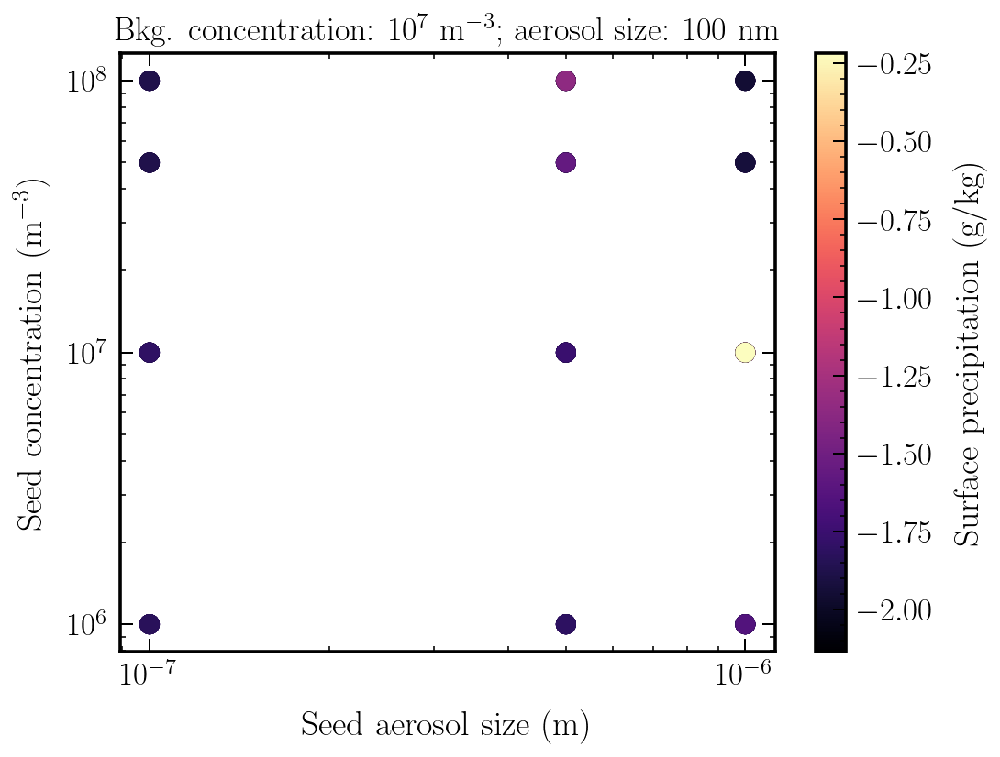

In [54]:
fig, ax= plt.subplots(figsize= (8, 6))
plt.scatter(seed_df.seed_size, seed_df.norm_seed, c= np.log10(seed_df.surf_precip_mean), cmap= 'magma', s= 100)
plt.xscale('log')
plt.yscale('log')
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'Seed aerosol size (m)')
plt.ylabel(r'Seed concentration (m$^{-3}$)')
plt.title(r'Bkg. concentration: $10^7$ m$^{-3}$; aerosol size: 100 nm')
plt.colorbar(label= r'Surface precipitation (g/kg)')
plt.savefig('../../plots/parameter_scan_2D/param_scan_2D_100nm.pdf', dpi= 300, bbox_inches= 'tight')

In [30]:
seed_df_2= pres_2D_flow_run_df.groupby('bkg_size').get_group(500.0 * si.nm)

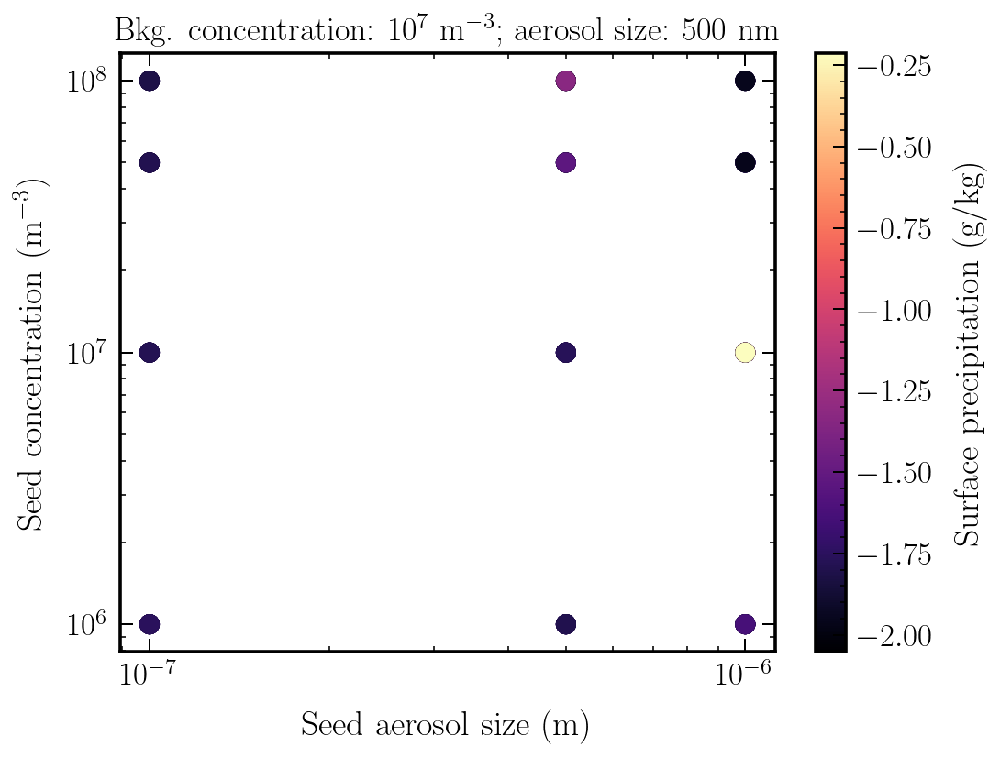

In [55]:
fig, ax= plt.subplots(figsize= (8, 6))
plt.scatter(seed_df_2.seed_size, seed_df_2.norm_seed, c= np.log10(seed_df_2.surf_precip_mean), cmap= 'magma', s= 100)
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'Seed aerosol size (m)')
plt.ylabel(r'Seed concentration (m$^{-3}$)')
plt.title(r'Bkg. concentration: $10^7$ m$^{-3}$; aerosol size: 500 nm')
plt.colorbar(label= r'Surface precipitation (g/kg)')
plt.savefig('../../plots/parameter_scan_2D/param_scan_2D_500nm.pdf', dpi= 300, bbox_inches= 'tight')

In [35]:
seed_df[(seed_df.norm_seed == 10 / si.cm ** 3)&(seed_df.seed_size == 1e3 * si.nm)]

,bkg_size,seed_size,norm_seed,z_part_seed,x_part_seed,surf_precip_mean
108,1.000000e-07,0.000001,10000000.0,"(0.0, 0.25)","(0.0, 0.25)",0.013300
109,1.000000e-07,0.000001,10000000.0,"(0.0, 0.25)","(0.25, 0.5)",0.019037
110,1.000000e-07,0.000001,10000000.0,"(0.0, 0.25)","(0.5, 0.75)",0.181132
111,1.000000e-07,0.000001,10000000.0,"(0.25, 0.5)","(0.0, 0.25)",0.014562
112,1.000000e-07,0.000001,10000000.0,"(0.25, 0.5)","(0.25, 0.5)",0.016372
113,1.000000e-07,0.000001,10000000.0,"(0.25, 0.5)","(0.5, 0.75)",0.174540
114,1.000000e-07,0.000001,10000000.0,"(0.5, 0.75)","(0.0, 0.25)",0.013709
115,1.000000e-07,0.000001,10000000.0,"(0.5, 0.75)","(0.25, 0.5)",0.020464
116,1.000000e-07,0.000001,10000000.0,"(0.5, 0.75)","(0.5, 0.75)",0.132714
117,1.000000e-07,0.000001,10000000.0,"(0.75, 1.0)","(0.0, 0.25)",0.010109


In [61]:
(2*3*5*4*3 * 120)/3600

12.0